<a href="https://colab.research.google.com/github/Helen-sew/Data-Analysis-with-Python/blob/main/Sew_Yok_Lian_100423_Project_Assignment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

 **CDA Block 5 Project Assignment**


##Introduction

We will be looking at the sales of a bicycle company. The data spans across sales, customer demographics and products. The datasets are just a small part of a much larger database. 

Such datasets are very common in a business setting, where different information are kept in different tables and connected via one or two variables (foreign keys).

The business objectives for this assignment are

1. Understanding more about the customers and their spending habits
2. Which group of customers to target
3. Predicting the lifetime value of each customer





### About the datasets

The file **aw_bicycle.xlsx** (in Block 5 data folder) contains a few sheets:

* **Sales Customer**: connecting file between customer and sales
* **Sales SalesOrderHeader**: information regarding sales orders (order/invoice level)
* **Sales SalesOrderDetail**: information regarding each sales item (itemized level)
* **Sales vPersonDemographics**: customer attributes (e.g. birthday, marital status, gender, etc.)
* **Production Product**: product name and attributes



To connect the datasets, here are the key columns/variables:

* **Sales Customer** to **Sales SalesOrderHeader**: *CustomerID*
* **Sales Customer** to **Sales vPersonDemographics**: *PersonID* to *BusinessEntityID*
* **Sales SalesOrderHeader** to **Sales SalesOrderDetail**: *SalesOrderID*
* **Sales SalesOrderDetail** to **Production Product**: *ProductID*



###**To do**

####RFM Clustering Analysis

1.   Connect the **SalesOrderDetail** to **SalesOrderHeader** such that you can perform a Recency, Frequency, Monetary analysis
  * **Recency**: Use the latest *OrderDate* as the benchmark to measure the number of days a customer (*CustomerID*) last purchased.
  * **Frequency**: Count the number of *SalesOrderID* at the detailed item level per customer.
  * **Monetary**: Sum the total of *LineTotal* (Quantity * Unit Price) at the detailed item level per customer.
  * Combine all 3 metrics at the customer level (each row is one unique customer).
  * Remove outliers if you need (trim by 1st and 99th percentile).

2. Perform a clustering (kmeans) analysis on the **RFM** dataset.
  * How many number of clusters did you choose and why?
  * Which group of customers are important in terms of RFM?
    * Is there enough customers in this group? If not, which other group should you focus your attention on?
  * Which group of customers you should ignore?

####Customer Lifetime Value Prediction

There are many definitions of lifetime value of a customer. The general idea is the **average spending of a customer** mulitipled by the **time they spend at your business**.

1. We will define lifetime value of a customer by using our RFM dataset (at per customer level).
  * Find the *average_spend_value* (average Spend value per customer) by taking *monetary* / *frequency*
  * Define *max_no_days* (maximum number of days) by the total length of days in the dataset (max - min *OrderDate*).
  * Define the *years_of_service* to each customer by taking (*max_no_days* - *recency*) / 365.
  * Define *lifetime_value* by multiplying *average_spend_value* by *years_of_service*.

2. We need some demographics of customers to help us predict what are the important factors that can help us predict the lifetime value. 
  * Connect the **RFM** dataset to **Sales vPersonDemographics** via **SalesCustomer**. Be sure to remove any NA records. 
  * Run a prediction model (Regression or Classification)
    * Target variable: *lifetime_value*.
    * Compare and select the best model based on minimum MAPE (Regression) or maximum F1 (Classification).
    * Explore the important features of the best model, and extract the demographics of the customers based on the important features. What can be said regarding such customers?
    * Optional: Plot and compare the customers between different groups
    * Optional: What are the kind of products the customers bought? Have to connect to **Production Product** dataset. 



#Setup

In [1]:
# Mount Google drive
from google.colab import drive 
drive.mount('/content/drive/')


Mounted at /content/drive/


In [ ]:
# install required packages
#!pip uninstall numpy==1.22.4
#!pip install numpy==1.20
!pip install swifter 
!pip install ydata-profiling
!pip install pycaret
!pip install shap
!pip install Jinja2
!pip install markupsafe==2.0.1


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 830.9/830.9 KB 27.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 70.6 MB/s eta 0:00:00
  Created wheel for swifter: filename=swifter-1.3.4-py3-none-any.whl size=16321 sha256=8413aba73481d672880773398091b24bb167e2986a8003e68eb9d579d36fdf14
  Stored in directory: /root/.cache/pip/wheels/2b/5e/f2/3931524f702ffd03309e96d35ee2fbf9c61c27377511ee8d4c
Successfully built swifter
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 345.9/345.9 KB 17.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 KB 12.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.8/33.8 MB 38.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 63.4 MB/s eta

In [ ]:
#import libraries needed
import os
import swifter
import pandas as pd
import numpy as np
import ydata_profiling
import seaborn as sns
import matplotlib.pyplot as plt

# Visualization setting
%matplotlib inline
sns.set_style('darkgrid')


In [ ]:
print(np.__version__)

1.22.4


#Read files

In [ ]:
# define folder path
folder_path = "/content/drive/MyDrive/cda_data/Block 5"
file_path = os.path.join(folder_path, "aw_bicycle.xlsx")


In [ ]:
# read in excel file
# https://pandas.pydata.org/docs/reference/api/pandas.read_excel.html

# read sales customer dataframe
df_sales_customer = pd.read_excel(file_path, sheet_name = "Sales Customer")
df_sales_customer.head(2)


,CustomerID,PersonID,StoreID,TerritoryID,AccountNumber,rowguid,ModifiedDate
0,11015,10963.0,NaN,4,AW00011015,F791BD74-EB82-4631-B9FC-F9FEE621FD13,2014-09-12 11:15:07
1,11016,3800.0,NaN,4,AW00011016,023843CA-25FB-42BF-AC37-FAF6F4120DAC,2014-09-12 11:15:07


In [ ]:
#print concise summary of df 
df_sales_customer.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19820 entries, 0 to 19819
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   CustomerID     19820 non-null  int64         
 1   PersonID       19119 non-null  float64       
 2   StoreID        1336 non-null   float64       
 3   TerritoryID    19820 non-null  int64         
 4   AccountNumber  19820 non-null  object        
 5   rowguid        19820 non-null  object        
 6   ModifiedDate   19820 non-null  datetime64[ns]
dtypes: datetime64[ns](1), float64(2), int64(2), object(2)
memory usage: 1.1+ MB


In [ ]:
# read sales order header
df_sales_order_header = pd.read_excel(file_path, sheet_name = 'Sales SalesOrderHeader')
df_sales_order_header.head(2)

,SalesOrderID,RevisionNumber,OrderDate,DueDate,ShipDate,Status,OnlineOrderFlag,SalesOrderNumber,PurchaseOrderNumber,AccountNumber,...,CreditCardID,CreditCardApprovalCode,CurrencyRateID,SubTotal,TaxAmt,Freight,TotalDue,Comment,rowguid,ModifiedDate
0,43702,8,2011-06-01,2011-06-13,2011-06-08,5,True,SO43702,NaN,10-4030-027645,...,8087.0,1230194Vi41919,NaN,3578.27,286.2616,89.4568,3953.9884,NaN,9310C7F0-9A84-4CE9-BE08-F700FB1AADF7,2011-06-08
1,43706,8,2011-06-02,2011-06-14,2011-06-09,5,True,SO43706,NaN,10-4030-027621,...,10912.0,230189Vi56258,NaN,3578.27,286.2616,89.4568,3953.9884,NaN,F02C4CB6-A5B5-4CE4-9473-CB084E383196,2011-06-09


In [ ]:
#print concise summary of df 
df_sales_order_header.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31465 entries, 0 to 31464
Data columns (total 26 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   SalesOrderID            31465 non-null  int64         
 1   RevisionNumber          31465 non-null  int64         
 2   OrderDate               31465 non-null  datetime64[ns]
 3   DueDate                 31465 non-null  datetime64[ns]
 4   ShipDate                31465 non-null  datetime64[ns]
 5   Status                  31465 non-null  int64         
 6   OnlineOrderFlag         31465 non-null  bool          
 7   SalesOrderNumber        31465 non-null  object        
 8   PurchaseOrderNumber     3806 non-null   object        
 9   AccountNumber           31465 non-null  object        
 10  CustomerID              31465 non-null  int64         
 11  SalesPersonID           3806 non-null   float64       
 12  TerritoryID             31465 non-null  int64 

In [ ]:
# read sales order details
df_sales_order_detail = pd.read_excel(file_path, sheet_name = 'Sales SalesOrderDetail')
df_sales_order_detail.head(2)

,SalesOrderID,SalesOrderDetailID,CarrierTrackingNumber,OrderQty,ProductID,SpecialOfferID,UnitPrice,UnitPriceDiscount,LineTotal,rowguid,ModifiedDate
0,51178,37753,NaN,1,870,1,4.99,0.0,4.99,EA75710F-2568-42FF-B92B-1518FE295200,2013-05-30
1,51180,37760,NaN,1,870,1,4.99,0.0,4.99,48A11063-A834-497E-B52B-82EE30589F4C,2013-05-30


In [ ]:
#print concise summary of df
df_sales_order_detail.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 121317 entries, 0 to 121316
Data columns (total 11 columns):
 #   Column                 Non-Null Count   Dtype         
---  ------                 --------------   -----         
 0   SalesOrderID           121317 non-null  int64         
 1   SalesOrderDetailID     121317 non-null  int64         
 2   CarrierTrackingNumber  60919 non-null   object        
 3   OrderQty               121317 non-null  int64         
 4   ProductID              121317 non-null  int64         
 5   SpecialOfferID         121317 non-null  int64         
 6   UnitPrice              121317 non-null  float64       
 7   UnitPriceDiscount      121317 non-null  float64       
 8   LineTotal              121317 non-null  float64       
 9   rowguid                121317 non-null  object        
 10  ModifiedDate           121317 non-null  datetime64[ns]
dtypes: datetime64[ns](1), float64(3), int64(5), object(2)
memory usage: 10.2+ MB


In [ ]:
# read in product file
df_product = pd.read_excel(file_path, 'Production Product')
df_product.head(2)

,ProductID,Name,ProductNumber,MakeFlag,FinishedGoodsFlag,Color,SafetyStockLevel,ReorderPoint,StandardCost,ListPrice,...,ProductLine,Class,Style,ProductSubcategoryID,ProductModelID,SellStartDate,SellEndDate,DiscontinuedDate,rowguid,ModifiedDate
0,1,Adjustable Race,AR-5381,False,False,NaN,1000,750,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,2008-04-30,NaT,NaN,694215B7-08F7-4C0D-ACB1-D734BA44C0C8,2014-02-08 10:01:36.827
1,2,Bearing Ball,BA-8327,False,False,NaN,1000,750,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,2008-04-30,NaT,NaN,58AE3C20-4F3A-4749-A7D4-D568806CC537,2014-02-08 10:01:36.827


In [ ]:
#print concise summary of df 
df_product.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 504 entries, 0 to 503
Data columns (total 25 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   ProductID              504 non-null    int64         
 1   Name                   504 non-null    object        
 2   ProductNumber          504 non-null    object        
 3   MakeFlag               504 non-null    bool          
 4   FinishedGoodsFlag      504 non-null    bool          
 5   Color                  256 non-null    object        
 6   SafetyStockLevel       504 non-null    int64         
 7   ReorderPoint           504 non-null    int64         
 8   StandardCost           504 non-null    float64       
 9   ListPrice              504 non-null    float64       
 10  Size                   211 non-null    object        
 11  SizeUnitMeasureCode    176 non-null    object        
 12  WeightUnitMeasureCode  205 non-null    object        
 13  Weigh

In [ ]:
# read in demographics file
df_demograhics = pd.read_excel(file_path, 'Sales vPersonDemographics')
df_demograhics.head(2)

,BusinessEntityID,TotalPurchaseYTD,DateFirstPurchase,BirthDate,MaritalStatus,YearlyIncome,Gender,TotalChildren,NumberChildrenAtHome,Education,Occupation,HomeOwnerFlag,NumberCarsOwned
0,3058,19.20,2004-04-07,1979-05-07,S,25001-50000,F,0.0,0.0,Partial College,Clerical,0.0,1.0
1,3246,557.49,2003-10-24,1975-11-07,S,25001-50000,F,0.0,0.0,Partial College,Clerical,0.0,1.0


In [ ]:
#print concise summary of df 
df_demograhics.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19972 entries, 0 to 19971
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   BusinessEntityID      19972 non-null  int64         
 1   TotalPurchaseYTD      19972 non-null  float64       
 2   DateFirstPurchase     18484 non-null  datetime64[ns]
 3   BirthDate             18484 non-null  datetime64[ns]
 4   MaritalStatus         18484 non-null  object        
 5   YearlyIncome          18484 non-null  object        
 6   Gender                18484 non-null  object        
 7   TotalChildren         18484 non-null  float64       
 8   NumberChildrenAtHome  18484 non-null  float64       
 9   Education             18484 non-null  object        
 10  Occupation            18484 non-null  object        
 11  HomeOwnerFlag         18484 non-null  float64       
 12  NumberCarsOwned       18484 non-null  float64       
dtypes: datetime64[ns

##Merge and explore transactional data

Transactional data is the information directly captured from transactions. It relates to an internal or external event and can be any business process, including financial or logistical processing. Transactional data is derived from transactions, while master data provides context to transactions.

Transactional data has a time dimension and may lose its relevance over time. Master data, on the other hand, has no time dimension and changes less often.

Overall, transactional data for a bicycle company would provide valuable information for managing inventory, tracking sales performance, and analyzing customer behavior.

In [ ]:
# merge product and sales detail file (main)
df_sales_by_product = df_product.merge(df_sales_order_detail, how = 'left', on = 'ProductID', suffixes = ('_prod', '_sales_det'))
df_sales_by_product.head()


#After running this code, df_sales_by_product will contain the merged dataframe with columns from both original dataframes. 
#The left join means that all rows from df_product will be included in the merged dataframe, and any matching rows from 
#df_sales_order_detail will be added to the right. If there is no matching row in df_sales_order_detail for a given ProductionID, 
#the corresponding columns will be filled with NaN values.

,ProductID,Name,ProductNumber,MakeFlag,FinishedGoodsFlag,Color,SafetyStockLevel,ReorderPoint,StandardCost,ListPrice,...,SalesOrderID,SalesOrderDetailID,CarrierTrackingNumber,OrderQty,SpecialOfferID,UnitPrice,UnitPriceDiscount,LineTotal,rowguid_sales_det,ModifiedDate_sales_det
0,1,Adjustable Race,AR-5381,False,False,NaN,1000,750,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaT
1,2,Bearing Ball,BA-8327,False,False,NaN,1000,750,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaT
2,323,Crown Race,CR-9981,False,False,NaN,1000,750,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaT
3,325,Decal 1,DC-8732,False,False,NaN,1000,750,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaT
4,326,Decal 2,DC-9824,False,False,NaN,1000,750,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaT


In [ ]:
#print concise summary of df 
df_sales_by_product.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 121555 entries, 0 to 121554
Data columns (total 35 columns):
 #   Column                  Non-Null Count   Dtype         
---  ------                  --------------   -----         
 0   ProductID               121555 non-null  int64         
 1   Name                    121555 non-null  object        
 2   ProductNumber           121555 non-null  object        
 3   MakeFlag                121555 non-null  bool          
 4   FinishedGoodsFlag       121555 non-null  bool          
 5   Color                   87204 non-null   object        
 6   SafetyStockLevel        121555 non-null  int64         
 7   ReorderPoint            121555 non-null  int64         
 8   StandardCost            121555 non-null  float64       
 9   ListPrice               121555 non-null  float64       
 10  Size                    69752 non-null   object        
 11  SizeUnitMeasureCode     50665 non-null   object        
 12  WeightUnitMeasureCode   54475 

In [ ]:
# merge sales order header and details (main)
df_sales_order_detail = df_sales_order_header.merge(df_sales_order_detail, how = 'left', on = 'SalesOrderID', suffixes=('_sales_header', '_sales_det'))
df_sales_order_detail.head()


,SalesOrderID,RevisionNumber,OrderDate,DueDate,ShipDate,Status,OnlineOrderFlag,SalesOrderNumber,PurchaseOrderNumber,AccountNumber,...,SalesOrderDetailID,CarrierTrackingNumber,OrderQty,ProductID,SpecialOfferID,UnitPrice,UnitPriceDiscount,LineTotal,rowguid_sales_det,ModifiedDate_sales_det
0,43702,8,2011-06-01,2011-06-13,2011-06-08,5,True,SO43702,NaN,10-4030-027645,...,358,NaN,1,750,1,3578.27,0.0,3578.27,C0B26057-26B3-40CD-B88B-B9986E6D382D,2011-06-01
1,43706,8,2011-06-02,2011-06-14,2011-06-09,5,True,SO43706,NaN,10-4030-027621,...,362,NaN,1,751,1,3578.27,0.0,3578.27,1D2F662D-D788-400E-9369-7CB0426CA32C,2011-06-02
2,43707,8,2011-06-02,2011-06-14,2011-06-09,5,True,SO43707,NaN,10-4030-027616,...,363,NaN,1,751,1,3578.27,0.0,3578.27,BF074A62-72E7-43E6-835B-18F19350666B,2011-06-02
3,43713,8,2011-06-04,2011-06-16,2011-06-11,5,True,SO43713,NaN,10-4030-027601,...,369,NaN,1,749,1,3578.27,0.0,3578.27,3AE2BD67-6F27-48EF-A9D7-6E77DE249E60,2011-06-04
4,43719,8,2011-06-05,2011-06-17,2011-06-12,5,True,SO43719,NaN,10-4030-027612,...,375,NaN,1,751,1,3578.27,0.0,3578.27,17962F1D-6303-437C-A399-6B99472E8388,2011-06-05


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
#print concise summary of df 
df_sales_order_detail.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 121317 entries, 0 to 121316
Data columns (total 36 columns):
 #   Column                     Non-Null Count   Dtype         
---  ------                     --------------   -----         
 0   SalesOrderID               121317 non-null  int64         
 1   RevisionNumber             121317 non-null  int64         
 2   OrderDate                  121317 non-null  datetime64[ns]
 3   DueDate                    121317 non-null  datetime64[ns]
 4   ShipDate                   121317 non-null  datetime64[ns]
 5   Status                     121317 non-null  int64         
 6   OnlineOrderFlag            121317 non-null  bool          
 7   SalesOrderNumber           121317 non-null  object        
 8   PurchaseOrderNumber        60919 non-null   object        
 9   AccountNumber              121317 non-null  object        
 10  CustomerID                 121317 non-null  int64         
 11  SalesPersonID              60919 non-null   float64 

In [ ]:
from ydata_profiling import ProfileReport


In [ ]:
# run pandas profiling to take a look at the sales order header and detailed data
report = ProfileReport(df_sales_order_detail, html={'style':{'full_width':True}}) 
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
report.to_file('profile_report.html')

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

#Data Cleaning 
To clean df_sales_order_detail for RFM computation 

* Handling duplicates - this involves 2 steps: Detecting duplicates and removing duplicates 

* Handling missing values - this involves 2 steps: Detecting the missing values and Treatment of the Missing Values

* Type conversion 




###Handling duplicates 

In [ ]:
#to check for duplicates in df_sales_order_detail 
df_sales_order_detail.duplicated()

#the 'False' indicating that there are no duplicate observations in df_sales_order_detail 
#and hence each observation is unique. 

0         False
1         False
2         False
3         False
4         False
          ...  
121312    False
121313    False
121314    False
121315    False
121316    False
Length: 121317, dtype: bool

###Handling missing values 


In [ ]:
#detecting the missing values in df_sales_order_detail by percentage 
df_sales_order_detail.isna().sum()/df_sales_order_detail.shape[0]

SalesOrderID                 0.000000
RevisionNumber               0.000000
OrderDate                    0.000000
DueDate                      0.000000
ShipDate                     0.000000
Status                       0.000000
OnlineOrderFlag              0.000000
SalesOrderNumber             0.000000
PurchaseOrderNumber          0.497853
AccountNumber                0.000000
CustomerID                   0.000000
SalesPersonID                0.497853
TerritoryID                  0.000000
BillToAddressID              0.000000
ShipToAddressID              0.000000
ShipMethodID                 0.000000
CreditCardID                 0.021209
CreditCardApprovalCode       0.021209
CurrencyRateID               0.620556
SubTotal                     0.000000
TaxAmt                       0.000000
Freight                      0.000000
TotalDue                     0.000000
Comment                      1.000000
rowguid_sales_header         0.000000
ModifiedDate_sales_header    0.000000
SalesOrderDe

In [ ]:
#remove columns or variables with missing values as they do not add value to our analysis. 

# drop columns with any missing values
df_sales_order_detail.dropna(axis=1, inplace=True)


In [ ]:
#to check if the columns with missing values are removed 
df_sales_order_detail.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 121317 entries, 0 to 121316
Data columns (total 29 columns):
 #   Column                     Non-Null Count   Dtype         
---  ------                     --------------   -----         
 0   SalesOrderID               121317 non-null  int64         
 1   RevisionNumber             121317 non-null  int64         
 2   OrderDate                  121317 non-null  datetime64[ns]
 3   DueDate                    121317 non-null  datetime64[ns]
 4   ShipDate                   121317 non-null  datetime64[ns]
 5   Status                     121317 non-null  int64         
 6   OnlineOrderFlag            121317 non-null  bool          
 7   SalesOrderNumber           121317 non-null  object        
 8   AccountNumber              121317 non-null  object        
 9   CustomerID                 121317 non-null  int64         
 10  TerritoryID                121317 non-null  int64         
 11  BillToAddressID            121317 non-null  int64   

###Type conversion 

Convert following variables to Categorial feature 
- SalesOrderID 
- RevisionNumber (2 unique number i.e. 8 & 9
-Status (1 unique number i.e. 5)
- CustomerID
- TerritoryID
- BillToAddressID
- ShipToAddressID
- ShipMethodID
- SalesOrderDetailID
- ProductID
- SpecialOfferID
 


In [ ]:
#Define a list of column names to covert 
cols_to_convert = ['SalesOrderID','RevisionNumber', 'Status', 'CustomerID','TerritoryID', 
'BillToAddressID', 'ShipToAddressID', 'ShipMethodID', 'SalesOrderDetailID', 'ProductID', 'SpecialOfferID']

#Loop over the columns and convert to string type 
for col in cols_to_convert: 
  df_sales_order_detail[col] = df_sales_order_detail[col].astype(str)

#verify the data types of the columns
df_sales_order_detail.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 121317 entries, 0 to 121316
Data columns (total 29 columns):
 #   Column                     Non-Null Count   Dtype         
---  ------                     --------------   -----         
 0   SalesOrderID               121317 non-null  object        
 1   RevisionNumber             121317 non-null  object        
 2   OrderDate                  121317 non-null  datetime64[ns]
 3   DueDate                    121317 non-null  datetime64[ns]
 4   ShipDate                   121317 non-null  datetime64[ns]
 5   Status                     121317 non-null  object        
 6   OnlineOrderFlag            121317 non-null  bool          
 7   SalesOrderNumber           121317 non-null  object        
 8   AccountNumber              121317 non-null  object        
 9   CustomerID                 121317 non-null  object        
 10  TerritoryID                121317 non-null  object        
 11  BillToAddressID            121317 non-null  object  

#Feature Engineering 

Next, we are going to engineer retail features that can help us segment customers according to relevant business objectives - (1) market share (revenue), (2) profit margin.

Retail transaction features that directly influence the above objectives:

> Recency (R)
>> Number of days since last purchase (measures customer repeat frequency, a measure of product demand, customer loyalty)
>
> Frequency (F)
>> Number of transactions
>
> Monetary (M)
>> Total revenue contributed

RFM analysis is a data-driven customer segmentation technique that uses historical customer data to identify the customers who are most valuable to a business. 

By analyzing these three dimensions, RFM analysis allows businesses to segment their customers into groups based on their behavior, and to tailor their marketing strategies to each group accordingly.

In [ ]:
# remove columns not needed from df_sales_order_detail for RFM calculations
df_sales_order_detail.drop(columns=['TerritoryID', 'RevisionNumber', 'Status', 'OnlineOrderFlag', 'AccountNumber', 
                                    'BillToAddressID', 'ShipToAddressID', 'ShipMethodID', 'SalesOrderDetailID', 
                                    'SpecialOfferID', 'rowguid_sales_header','ModifiedDate_sales_header', 'rowguid_sales_det', 'ModifiedDate_sales_det'], inplace=True)


In [ ]:
df_sales_order_detail

,SalesOrderID,OrderDate,DueDate,ShipDate,SalesOrderNumber,CustomerID,SubTotal,TaxAmt,Freight,TotalDue,OrderQty,ProductID,UnitPrice,UnitPriceDiscount,LineTotal
0,43702,2011-06-01,2011-06-13,2011-06-08,SO43702,27645,3578.2700,286.2616,89.4568,3953.9884,1,750,3578.2700,0.00,3578.270000
1,43706,2011-06-02,2011-06-14,2011-06-09,SO43706,27621,3578.2700,286.2616,89.4568,3953.9884,1,751,3578.2700,0.00,3578.270000
2,43707,2011-06-02,2011-06-14,2011-06-09,SO43707,27616,3578.2700,286.2616,89.4568,3953.9884,1,751,3578.2700,0.00,3578.270000
3,43713,2011-06-04,2011-06-16,2011-06-11,SO43713,27601,3578.2700,286.2616,89.4568,3953.9884,1,749,3578.2700,0.00,3578.270000
4,43719,2011-06-05,2011-06-17,2011-06-12,SO43719,27612,3578.2700,286.2616,89.4568,3953.9884,1,751,3578.2700,0.00,3578.270000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
121312,71920,2014-05-01,2014-05-13,2014-05-08,SO71920,29982,2527.1280,238.4634,74.5198,2840.1112,1,976,1020.5940,0.00,1020.594000
121313,71920,2014-05-01,2014-05-13,2014-05-08,SO71920,29982,2527.1280,238.4634,74.5198,2840.1112,1,876,72.0000,0.00,72.000000
121314,71923,2014-05-01,2014-05-13,2014-05-08,SO71923,29781,96.1088,8.5233,2.6635,107.2956,14,875,5.2142,0.02,71.538824
121315,71923,2014-05-01,2014-05-13,2014-05-08,SO71923,29781,96.1088,8.5233,2.6635,107.2956,4,874,5.3940,0.00,21.576000


#### Step 1: Compute Recency

In [ ]:
#### create recency variable
# based on latest OrderDate as days = 0 (max OrderDate - current line OrderDate)

df_sales_order_detail['recency'] = max(df_sales_order_detail.OrderDate) - df_sales_order_detail.OrderDate


In [ ]:
#sort the recency column by ascending order 
df_sales_order_detail.sort_values('recency', ascending=True)

,SalesOrderID,OrderDate,DueDate,ShipDate,SalesOrderNumber,CustomerID,SubTotal,TaxAmt,Freight,TotalDue,OrderQty,ProductID,UnitPrice,UnitPriceDiscount,LineTotal,recency
11775,75101,2014-06-30,2014-07-12,2014-07-07,SO75101,20201,133.4900,10.6792,3.3373,147.5065,1,866,63.5000,0.0,63.5000,0 days
33305,75111,2014-06-30,2014-07-12,2014-07-07,SO75111,19072,48.9700,3.9176,1.2243,54.1119,1,708,34.9900,0.0,34.9900,0 days
33304,75111,2014-06-30,2014-07-12,2014-07-07,SO75111,19072,48.9700,3.9176,1.2243,54.1119,1,921,4.9900,0.0,4.9900,0 days
20522,75085,2014-06-30,2014-07-12,2014-07-07,SO75085,11927,16.9400,1.3552,0.4235,18.7187,1,712,8.9900,0.0,8.9900,0 days
20523,75085,2014-06-30,2014-07-12,2014-07-07,SO75085,11927,16.9400,1.3552,0.4235,18.7187,1,877,7.9500,0.0,7.9500,0 days
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84529,43673,2011-05-31,2011-06-12,2011-06-07,SO43673,29844,3746.2015,357.9614,111.8629,4216.0258,1,729,183.9382,0.0,183.9382,1126 days
84530,43673,2011-05-31,2011-06-12,2011-06-07,SO43673,29844,3746.2015,357.9614,111.8629,4216.0258,1,762,419.4589,0.0,419.4589,1126 days
84531,43682,2011-05-31,2011-06-12,2011-06-07,SO43682,29759,3875.7229,371.8002,116.1876,4363.7107,2,758,874.7940,0.0,1749.5880,1126 days
84533,43682,2011-05-31,2011-06-12,2011-06-07,SO43682,29759,3875.7229,371.8002,116.1876,4363.7107,2,770,419.4589,0.0,838.9178,1126 days


In [ ]:
#to check and confirm that there is more than one transaction for each customer 
df_sales_order_detail['CustomerID'].nunique()

19119

In [ ]:
#to extract the latest transaction on a customer basis 
#The .min() function is then used to calculate the minimum (i.e., most recent) recency value for each customer
rfm_r = df_sales_order_detail.groupby('CustomerID')['recency'].min() 
rfm_r

CustomerID
11000   270 days
11001    49 days
11002   339 days
11003   263 days
11004   272 days
          ...   
30114   121 days
30115    91 days
30116   121 days
30117    91 days
30118    60 days
Name: recency, Length: 19119, dtype: timedelta64[ns]

In [ ]:
#Reset index and set CustomerID as index 
#Setting CustomerID as index will reduce merging error if we are confused between append, concat, merge 
rfm_r = rfm_r.reset_index().set_index('CustomerID')
rfm_r

,recency
CustomerID,
11000,270 days
11001,49 days
11002,339 days
11003,263 days
11004,272 days
...,...
30114,121 days
30115,91 days
30116,121 days


In [ ]:
#For modeling purposes, we need to convert a datatime object (in this case, a timedelta object)
#to an integer/float. For this use-case, number of days is the most 
#approprite. 
rfm_r['recency'] = rfm_r.recency.dt.days 
rfm_r 


,recency
CustomerID,
11000,270
11001,49
11002,339
11003,263
11004,272
...,...
30114,121
30115,91
30116,121


If the recency is 0 day in RFM analysis, it means that the customer made a purchase on the most recent day in the dataset. This indicates that the customer has a high level of engagement with the business or brand, as they have recently interacted with it.

In general, customers with a low recency score are considered more valuable than those with a high recency score, as they are more likely to make a purchase again in the near future. However, a recency score of 0 may indicate that the customer is already highly engaged with the business, and may not necessarily need immediate attention or incentives to make another purchase.

Therefore, it is important to consider other RFM metrics such as frequency and monetary value in addition to recency, to gain a more complete understanding of each customer's behavior and potential value to the business.

#### Step 2: Compute Frequency 

In [ ]:
df_sales_order_detail.tail(10)

,SalesOrderID,OrderDate,DueDate,ShipDate,SalesOrderNumber,CustomerID,SubTotal,TaxAmt,Freight,TotalDue,OrderQty,ProductID,UnitPrice,UnitPriceDiscount,LineTotal,recency
121307,71915,2014-05-01,2014-05-13,2014-05-08,SO71915,29638,1732.8900,170.9785,53.4308,1957.2993,1,940,48.5940,0.00,48.594000,60 days
121308,71920,2014-05-01,2014-05-13,2014-05-08,SO71920,29982,2527.1280,238.4634,74.5198,2840.1112,7,884,32.3940,0.00,226.758000,60 days
121309,71920,2014-05-01,2014-05-13,2014-05-08,SO71920,29982,2527.1280,238.4634,74.5198,2840.1112,3,938,24.2940,0.00,72.882000,60 days
121310,71920,2014-05-01,2014-05-13,2014-05-08,SO71920,29982,2527.1280,238.4634,74.5198,2840.1112,3,864,38.1000,0.00,114.300000,60 days
121311,71920,2014-05-01,2014-05-13,2014-05-08,SO71920,29982,2527.1280,238.4634,74.5198,2840.1112,1,973,1020.5940,0.00,1020.594000,60 days
121312,71920,2014-05-01,2014-05-13,2014-05-08,SO71920,29982,2527.1280,238.4634,74.5198,2840.1112,1,976,1020.5940,0.00,1020.594000,60 days
121313,71920,2014-05-01,2014-05-13,2014-05-08,SO71920,29982,2527.1280,238.4634,74.5198,2840.1112,1,876,72.0000,0.00,72.000000,60 days
121314,71923,2014-05-01,2014-05-13,2014-05-08,SO71923,29781,96.1088,8.5233,2.6635,107.2956,14,875,5.2142,0.02,71.538824,60 days
121315,71923,2014-05-01,2014-05-13,2014-05-08,SO71923,29781,96.1088,8.5233,2.6635,107.2956,4,874,5.3940,0.00,21.576000,60 days
121316,71923,2014-05-01,2014-05-13,2014-05-08,SO71923,29781,96.1088,8.5233,2.6635,107.2956,1,870,2.9940,0.00,2.994000,60 days


Frequency metric is calculated by counting the number of unique items per transaction that a customer makes. Each unique item in the dataset is indicated under the respective SalesOrderID, which means that the metric can be calculated by counting the number of distinct ProductID associated with each SalesOrderID.

For example, if a customer makes a purchase with SalesOrderID number 71920 (see above cell) and the associated ProductID are 884, 938, 864, 973, 976 and 876, the number of unique items per transaction for that customer would be 6.

Why unique items per transaction and not number of items purchased?
Due to the nature of the items purchased, if we use number of items purchased, we will end up giving more weights to customers that purchase small items at high quantity.

For example, if a customer purchases 100 units of a single low-value item in one transaction, it may not necessarily indicate high engagement or loyalty with the business. On the other hand, if a customer purchases 10 different items in one transaction, it may indicate that they are exploring a wider range of products offered by the business, which could be a better indicator of engagement and loyalty.

Why unique items per transactions and not number of
unique invoices? Some customers may purchase a large
number of items per invoice while others may split up
their purchases in multiple invoices. This could be due to various factors, such as discounts, unique circumstances, or personal preferences.

To address these confounding factors, RFM analysis balances different considerations and uses unique items per transaction as a metric. By looking at the number of unique items per transaction, businesses can get a more complete view of a customer's purchase behavior, including the variety of items that they are interested in and the frequency of their purchases.

Moreover, unique items per transaction can help businesses identify cross-selling opportunities, such as offering complementary products to customers who frequently purchase a particular item. This can lead to increased sales and customer satisfaction.



In [ ]:
rfm_f = df_sales_order_detail.groupby('CustomerID')['SalesOrderID'].count()
rfm_f


CustomerID
11000      8
11001     11
11002      4
11003      9
11004      6
        ... 
30114     30
30115     21
30116    119
30117    436
30118    289
Name: SalesOrderID, Length: 19119, dtype: int64

In [ ]:
#Reset index and set CustomerID as index 
#Setting CustomerID as index will reduce merging errors if we are confused between append, concat, merge 
rfm_f = rfm_f.reset_index().set_index('CustomerID')
#rename column name to frequency 
rfm_f.rename({'SalesOrderID': 'frequency'}, axis=1, inplace=True)
rfm_f

,frequency
CustomerID,
11000,8
11001,11
11002,4
11003,9
11004,6
...,...
30114,30
30115,21
30116,119


#### Step 3: Compute Monetary

In [ ]:
df_sales_order_detail.tail()

,SalesOrderID,OrderDate,DueDate,ShipDate,SalesOrderNumber,CustomerID,SubTotal,TaxAmt,Freight,TotalDue,OrderQty,ProductID,UnitPrice,UnitPriceDiscount,LineTotal,recency
121312,71920,2014-05-01,2014-05-13,2014-05-08,SO71920,29982,2527.1280,238.4634,74.5198,2840.1112,1,976,1020.5940,0.00,1020.594000,60 days
121313,71920,2014-05-01,2014-05-13,2014-05-08,SO71920,29982,2527.1280,238.4634,74.5198,2840.1112,1,876,72.0000,0.00,72.000000,60 days
121314,71923,2014-05-01,2014-05-13,2014-05-08,SO71923,29781,96.1088,8.5233,2.6635,107.2956,14,875,5.2142,0.02,71.538824,60 days
121315,71923,2014-05-01,2014-05-13,2014-05-08,SO71923,29781,96.1088,8.5233,2.6635,107.2956,4,874,5.3940,0.00,21.576000,60 days
121316,71923,2014-05-01,2014-05-13,2014-05-08,SO71923,29781,96.1088,8.5233,2.6635,107.2956,1,870,2.9940,0.00,2.994000,60 days


In [ ]:
#### create monetary variable
# Monetary metric is simply total revenue generated by each customer 
# use LineTotal (can be computed by quantity * unit_price)
# LineTotal is the total amount for each line item
# sum LineTotal, groupby CustomerID

rfm_m = df_sales_order_detail.groupby('CustomerID')['LineTotal'].sum().round(2)
rfm_m

CustomerID
11000      8248.99
11001      6383.88
11002      8114.04
11003      8139.29
11004      8196.01
           ...    
30114     11652.99
30115      8917.56
30116    187114.20
30117    816755.58
30118    278568.57
Name: LineTotal, Length: 19119, dtype: float64

In [ ]:
#set the index as CustomerID
#rename column name to 'monetary'
rfm_m = rfm_m.reset_index().set_index('CustomerID')
rfm_m.rename({'LineTotal': 'monetary'}, axis=1, inplace=True)
rfm_m

,monetary
CustomerID,
11000,8248.99
11001,6383.88
11002,8114.04
11003,8139.29
11004,8196.01
...,...
30114,11652.99
30115,8917.56
30116,187114.20


#### Step 4: Merging

Here, we pool all the dataframes together so that we have the RFM metrics per customer.


In [ ]:
# combine recency, frequency, monetary datasets together
# makign sure there are no missing values
# CustomerID should be the index, 'recency', 'frequency, 'monetary' should be the columns
# We use the concat function so that we can merge all 3 dataframes in 1 pass.

rfm = pd.concat([rfm_r, rfm_f, rfm_m], axis=1, join='inner')
rfm

#Lastly, since we require all rows to have values, we user inner join which will drop any customer id that have missing value 
#for either R, F, M. 



,recency,frequency,monetary
CustomerID,,,
11000,270,8,8248.99
11001,49,11,6383.88
11002,339,4,8114.04
11003,263,9,8139.29
11004,272,6,8196.01
...,...,...,...
30114,121,30,11652.99
30115,91,21,8917.56
30116,121,119,187114.20


####Inspecting the dataset 

In [ ]:
rfm.info()

<class 'pandas.core.frame.DataFrame'>
Index: 19119 entries, 11000 to 30118
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   recency    19119 non-null  int64  
 1   frequency  19119 non-null  int64  
 2   monetary   19119 non-null  float64
dtypes: float64(1), int64(2)
memory usage: 1.1+ MB


In [ ]:
rfm.describe()

,recency,frequency,monetary
count,19119.000000,19119.000000,19119.000000
mean,190.267483,6.345363,5745.404156
std,150.423605,26.478444,38800.383353
min,0.000000,1.000000,1.370000
25%,85.000000,2.000000,54.980000
50%,165.000000,3.000000,548.980000
75%,263.000000,4.000000,2822.385000
max,1126.000000,530.000000,877107.190000


In [1]:
rfm.describe().T

NameError: ignored

In [ ]:
rfm.to_excel("rfm.xlsx")

In [ ]:
rfm_report = rfm.profile_report(minimal=True)
#df.profile_report(explorative=True)
# rfm_report = ProfileReport(rfm, minimal=True, html={'style':{'full_width':True}}) 
rfm_report.to_file('profile_report_rfm.html')
rfm_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

<Axes: xlabel='monetary'>

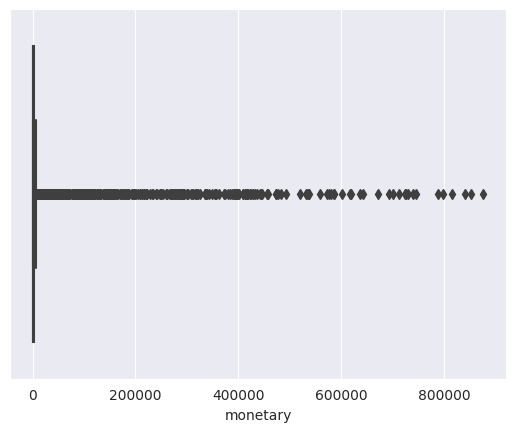

In [ ]:
#checking outliers on 'monetary' column
#the min value is 1.37 and max value is 877,107.19 suggests that there 
#may be one or more outliers in the dataset. 
# plot boxplot of 'monetary'

sns.boxplot(x=rfm['monetary'], orient='h')



The length of the box represents the IQR, which indicates the spread of the middle 50% of the data.
The median is the line within the box, which represents the value that falls in the middle of the dataset.
The whiskers extend to the minimum and maximum values that are within 1.5 times the IQR of the lower and upper quartiles, respectively.
Any values outside of the whiskers are considered outliers and are shown as individual points on the plot.
By examining the box plot, we can gain insights into the distribution of the data, including the spread of the data, the presence of outliers, and the central tendency of the data. This information can be useful for making decisions about the data or for identifying areas that may require further investigation

##remove outliers by monetary

In [ ]:
#### removing outliers 
# trim the dataset at 1 percentile and 99th percentile
# which means removing records below 1st percentile and above 99th percentile
# first, establish the 1st and 99th percentile
p1 = rfm.monetary.quantile(0.01)
p99 = rfm.monetary.quantile(0.99)

# Check the descriptive statistics to see if the numbers are better (especially monetary)
rfm[(rfm.monetary >= p1) & (rfm.monetary <= p99)].describe()

,recency,frequency,monetary
count,18851.000000,18851.000000,18851.000000
mean,190.459339,4.106838,2366.388191
std,149.985116,8.686692,8216.586396
min,0.000000,1.000000,4.990000
25%,85.000000,2.000000,54.980000
50%,166.000000,3.000000,548.980000
75%,264.000000,4.000000,2751.420000
max,1126.000000,181.000000,144602.580000


In [ ]:
# apply the changes to remove records below and above 99th percentile
rfm = rfm[(rfm.monetary >= p1) & (rfm.monetary <= p99)]

In [ ]:
# output cleaned file so can refer to this file in the future
rfm

,recency,frequency,monetary
CustomerID,,,
11000,270,8,8248.99
11001,49,11,6383.88
11002,339,4,8114.04
11003,263,9,8139.29
11004,272,6,8196.01
...,...,...,...
30106,426,114,101203.58
30108,457,105,144602.58
30110,426,6,1625.28


In [ ]:
# use pandas profiling to check the RFM dataset
rfm_report = rfm.profile_report(minimal=True)
rfm_report.to_file('profile_report_rfm.html')
rfm_report

/usr/local/lib/python3.9/dist-packages/ydata_profiling/utils/dataframe.py:137: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.rename(columns={"index": "df_index"}, inplace=True)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

#Clustering (Kmeans)

####Step 1 : Setup

In [ ]:
# run clustering using pycaret
from pycaret.clustering import *

In [ ]:
model = setup(data=rfm,
              normalize=True,
              normalize_method='zscore',
              session_id=75)

,Description,Value
0,Session id,75
1,Original data shape,"(18851, 3)"
2,Transformed data shape,"(18851, 3)"
3,Numeric features,3
4,Preprocess,True
5,Imputation type,simple
6,Numeric imputation,mean
7,Categorical imputation,mode
8,Normalize,True
9,Normalize method,zscore


####Step 2 : To identify number of clusters 

In [ ]:
# run through multiple clusters to check which has the best results
# create empty dataframe to store results
results = pd.DataFrame()

#tqdm.trange allows us to see a progress bar when we use range function 

from tqdm import trange

for i in trange(2, 11):
    kmeans = create_model('kmeans',
                          num_clusters=i,
                          init='k-means++',
                          n_init=10,
                          max_iter=300,
                          random_state=75
                          )
    metrics = pull()  # Extract results table into dataframe
    metrics['algo'] = 'kmeans'
    metrics['num_clusters'] = i
    results = results.append(metrics)


  0%|          | 0/9 [00:00<?, ?it/s]

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.9144,18535.0406,0.4487,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

 11%|█         | 1/9 [00:07<00:57,  7.19s/it]

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.4706,18745.3651,0.6844,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

 22%|██▏       | 2/9 [00:12<00:44,  6.30s/it]

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.4829,21268.6839,0.6080,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

 33%|███▎      | 3/9 [00:20<00:40,  6.71s/it]

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.4901,22638.4052,0.7135,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

 44%|████▍     | 4/9 [00:25<00:31,  6.40s/it]

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.4943,21643.9463,0.7699,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

 56%|█████▌    | 5/9 [00:31<00:24,  6.11s/it]

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3929,21995.3865,0.8383,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

 67%|██████▋   | 6/9 [00:39<00:20,  6.88s/it]

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3926,21122.8836,0.8733,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

 78%|███████▊  | 7/9 [00:45<00:12,  6.35s/it]

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3931,20556.3562,0.9195,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

 89%|████████▉ | 8/9 [00:51<00:06,  6.40s/it]

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3935,20053.0562,0.8995,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

100%|██████████| 9/9 [00:58<00:00,  6.48s/it]


In [ ]:
# Sillhoutte and Calinski-Harabasz, greater the better
# Davies-Boudlin record in get_metrics() is wrong, should be lower the better
get_metrics()

,Name,Display Name,Score Function,Scorer,Target,Args,Greater is Better,Needs Ground Truth,Custom
ID,,,,,,,,,
silhouette,Silhouette,Silhouette,<function silhouette_score at 0x7ffa2e90f0d0>,make_scorer(silhouette_score),pred,{},True,False,False
chs,Calinski-Harabasz,Calinski-Harabasz,<function calinski_harabasz_score at 0x7ffa2e9...,make_scorer(calinski_harabasz_score),pred,{},True,False,False
db,Davies-Bouldin,Davies-Bouldin,<function davies_bouldin_score at 0x7ffa2e90f310>,make_scorer(davies_bouldin_score),pred,{},True,False,False
hs,Homogeneity Score,Homogeneity,<function homogeneity_score at 0x7ffa2e91d5e0>,make_scorer(homogeneity_score),pred,{},True,True,False
ari,Rand Index,Rand Index,<function adjusted_rand_score at 0x7ffa2e91d4c0>,make_scorer(adjusted_rand_score),pred,{},True,True,False
cs,Completeness Score,Completeness,<function completeness_score at 0x7ffa2e91d670>,make_scorer(completeness_score),pred,{},True,True,False


3 different clustering performance metrics: 

Metrics for unknown categories (unsupervised):

1. Silhouette Coefficient: measures the compactness and separation of clusters, by computing the average distance between points in the same cluster and the average distance between points in different clusters. It takes values between -1 and 1, where a higher value indicates a better clustering performance. 

2. Calinski-Harabasz Index: measures the ratio of between-cluster variance to within-cluster variance, by comparing the sum of squared distances between each point and its cluster centroid to the sum of squared distances between each point and the overall centroid. A higher value indicates better clustering performance.

3. Davies-Bouldin Index: measures the average similarity between each cluster and its most similar cluster, relative to the average dissimilarity between each cluster and its most dissimilar cluster. It takes values between 0 and infinity, where a lower value indicates a better clustering performance.

In [ ]:
# check the results of mulitiple number of clusters

results

# Silhoutte says 2 clusters
# Calinski says 5 or more clusteres
# Davis says 2 clusters (smaller is better)
# plot model says 4

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness,algo,num_clusters
0,0.9144,18535.0406,0.4487,0,0,0,kmeans,2
0,0.4706,18745.3651,0.6844,0,0,0,kmeans,3
0,0.4829,21268.6839,0.6080,0,0,0,kmeans,4
0,0.4901,22638.4052,0.7135,0,0,0,kmeans,5
0,0.4943,21643.9463,0.7699,0,0,0,kmeans,6
0,0.3929,21995.3865,0.8383,0,0,0,kmeans,7
0,0.3926,21122.8836,0.8733,0,0,0,kmeans,8
0,0.3931,20556.3562,0.9195,0,0,0,kmeans,9
0,0.3935,20053.0562,0.8995,0,0,0,kmeans,10


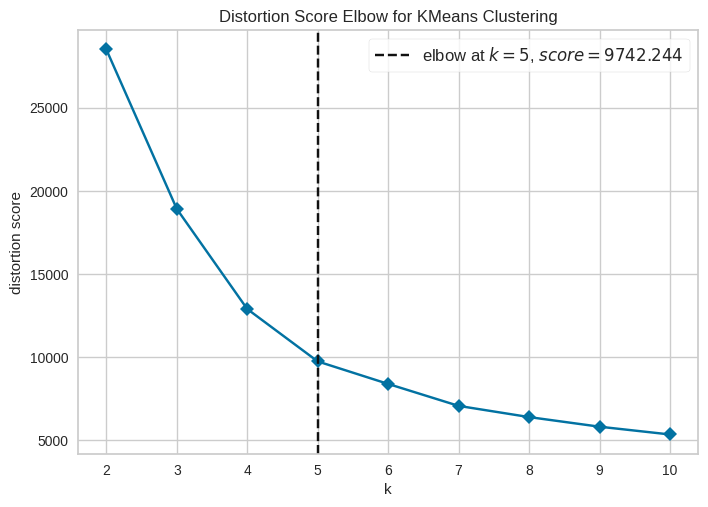

In [ ]:
# plot the elbow plot to confirm 4 is recommended
plot_model(best_model, plot='elbow')


The Silhouette scores seem to imply that 2 clusters are the best!

It seems that the Calinski-Harabasz suggests the more clusters the better! Note that Calinski-Harabasz compares variance, so numeric differences are squared (larger than normal).

Recall that the Calinski-Harabasz score measures the dispersion within cluster against dispersion between clusters. The data could be dispersed pretty evenly.

The Davies-Bouldin score measures distance between clusters vs the size of the cluster itself.

The results are consistent with the rest of the metrics done prior, but was very clear on which number of clusters is best - 2.

So how many clusters should we use? The practical consideration here is to balance between sufficient and overwhelming diversity.

I am inclined to choose 4 clusters.


####Step 3 - assign cluster numbers to the rfm_df

In [ ]:
# let's go with 4 clusters
# create model based on 4 clusters

best_model = create_model('kmeans',
                          num_clusters=4,
                          init='k-means++',
                          n_init=10,
                          max_iter=300,
                          random_state=75
                          )


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.4829,21268.6839,0.6080,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

In [ ]:
# assign the cluster number (starting from 0) to the RFM dataset
rfm_df = assign_model(best_model)


In [ ]:
# reset the index so the CustomerID becomes a column
rfm_df = rfm_df.reset_index()

In [ ]:
rfm_df

,CustomerID,recency,frequency,monetary,Cluster
0,11000,270,8,8248.990234,Cluster 2
1,11001,49,11,6383.879883,Cluster 0
2,11002,339,4,8114.040039,Cluster 2
3,11003,263,9,8139.290039,Cluster 2
4,11004,272,6,8196.009766,Cluster 2
...,...,...,...,...,...
18846,30106,426,114,101203.578125,Cluster 1
18847,30108,457,105,144602.578125,Cluster 1
18848,30110,426,6,1625.280029,Cluster 2
18849,30114,121,30,11652.990234,Cluster 0


In [ ]:
rfm_df.Cluster.value_counts()

Cluster 0    10398
Cluster 2     7920
Cluster 3      392
Cluster 1      141
Name: Cluster, dtype: int64

####Step 4: Inspecting the results 

Text(0.5, 1.0, 'Box Plot for Recency by Cluster')

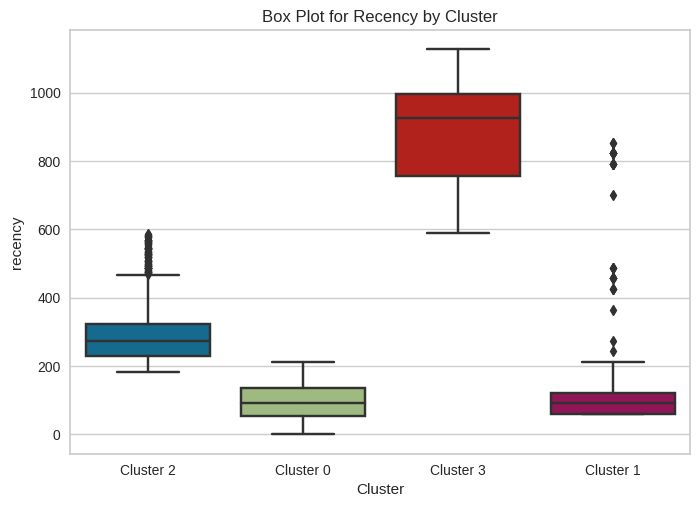

In [ ]:
# Clusters vs Recency

#create a box plot of 'recency' for each cluster 
sns.boxplot(x='Cluster', y='recency', data=rfm_df)

plt.title("Box Plot for Recency by Cluster")

Each box represents the distribution of 'recency' values for each cluster, with the horizontal line inside the box indicating the median value. The whiskers represent the range of the data points within 1.5 times the interquartile range (IQR) from the upper and lower quartiles, and any data points outside this range are considered outliers.



Text(0.5, 1.0, 'Box Plot of Frequency by Cluster')

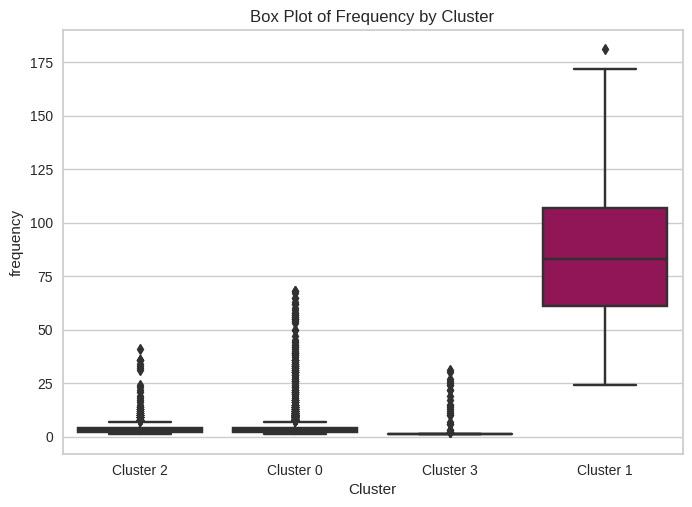

In [ ]:
# Clusters vs Frequency

#create a box plot of 'frequency' for each cluster 
sns.boxplot(x='Cluster', y='frequency', data=rfm_df)

plt.title("Box Plot of Frequency by Cluster")


Text(0.5, 1.0, 'Box Plot of Monetary by Cluster')

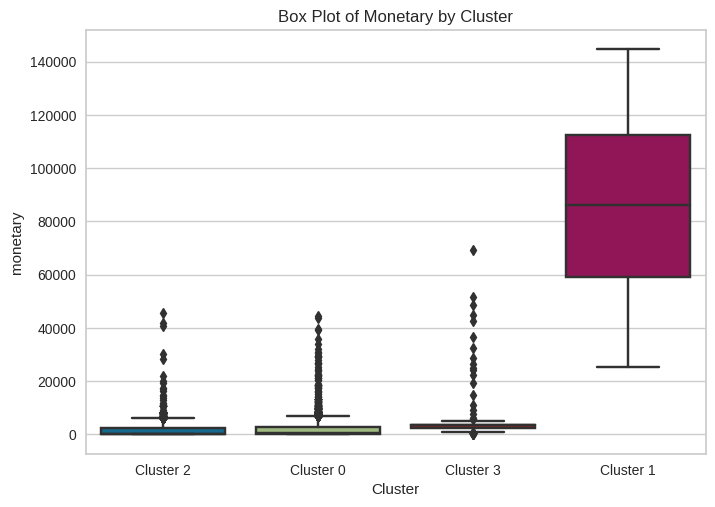

In [ ]:
# Clusters vs Monetary Value

#create a box plot of 'monetary' for each cluster 
sns.boxplot(x='Cluster', y='monetary', data=rfm_df)

plt.title("Box Plot of Monetary by Cluster")


####Step 5: Conclusion 
####Which cluster of customers are the most important? 

Based on clustering analysis result, cluster 1 and 2 are important to the bicycle company for different reasons. 

Cluster 1, with high recency, high frequency, and high monetary value, represents customers who have recently made purchases, make frequent purchases, and spend a significant amount of money on each purchase. These customers are highly engaged with the company and are likely to be loyal customers who have a high potential for repeat business. Therefore, it is important for the bicylce company to focus on retaining these customers by providing excellent customer service, targeted marketing, and loyalty rewards programs. However, 
the impact of targeting this cluster may be limited due to its small size. 

Cluster 2, with high recency, low frequency, and low monetary value, represents customers who have made fewer purchases, spend less money, and they have made a purchase recently. While these customers may not be as immediately profitable as those in cluster 1, they still represent a significant customer base for the bicycle company. It is important for the company to engage with these customers and encourage them to make more purchases by personalized outreach, special promotions or discounts, improved customer experience, product recommendation etc to create a more personalized and targeted experience that speaks to their specific needs and interests. By using data and analytics to understand these customers better, bicycle company can develop strategies to re-engage and convert them into more active and valuable customers over time.

In summary, both clusters are important to the bicycle company, and the company should develop strategies to retain high-value customers in cluster 3 while also engaging with customers in cluster 2 to encourage repeat business.



#Calculate lifetime value per customer

In [ ]:
# calculate the average spend value per customer by taking monetary (total amount spent) / frequency (how many times spent)
ave_spend_value = rfm_df['monetary']/rfm_df['frequency']
ave_spend_value

0        1031.123779
1         580.352717
2        2028.510010
3         904.365560
4        1366.001628
            ...     
18846     887.750685
18847    1377.167411
18848     270.880005
18849     388.433008
18850     424.645694
Length: 18851, dtype: float64

In [ ]:
# calculate the maximum number of days in the dataset
max_no_days = rfm_df['recency'].max()
max_no_days

1126

In [ ]:
# find out how long the company has been serving each customer: years of service
# max_no_days - recency
years_of_service = max_no_days - rfm_df['recency']
years_of_service 


0         856
1        1077
2         787
3         863
4         854
         ... 
18846     700
18847     669
18848     700
18849    1005
18850    1035
Name: recency, Length: 18851, dtype: int32

In [ ]:
# calculate lifetime value
# average spend value * years of service
rfm_df['lifetime_value'] = ave_spend_value * years_of_service
rfm_df


,CustomerID,recency,frequency,monetary,Cluster,lifetime_value
0,11000,270,8,8248.990234,Cluster 2,8.826420e+05
1,11001,49,11,6383.879883,Cluster 0,6.250399e+05
2,11002,339,4,8114.040039,Cluster 2,1.596437e+06
3,11003,263,9,8139.290039,Cluster 2,7.804675e+05
4,11004,272,6,8196.009766,Cluster 2,1.166565e+06
...,...,...,...,...,...,...
18846,30106,426,114,101203.578125,Cluster 1,6.214255e+05
18847,30108,457,105,144602.578125,Cluster 1,9.213250e+05
18848,30110,426,6,1625.280029,Cluster 2,1.896160e+05
18849,30114,121,30,11652.990234,Cluster 0,3.903752e+05


In [ ]:
rfm_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18851 entries, 0 to 18850
Data columns (total 6 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   CustomerID      18851 non-null  object 
 1   recency         18851 non-null  int32  
 2   frequency       18851 non-null  int32  
 3   monetary        18851 non-null  float32
 4   Cluster         18851 non-null  object 
 5   lifetime_value  18851 non-null  float64
dtypes: float32(1), float64(1), int32(2), object(2)
memory usage: 662.9+ KB


#Get in customer demographics

In [ ]:
# read in Sales vPersonDemographics to get Customer demographics
df_demograhics.head()


,BusinessEntityID,TotalPurchaseYTD,DateFirstPurchase,BirthDate,MaritalStatus,YearlyIncome,Gender,TotalChildren,NumberChildrenAtHome,Education,Occupation,HomeOwnerFlag,NumberCarsOwned
0,3058,19.20,2004-04-07,1979-05-07,S,25001-50000,F,0.0,0.0,Partial College,Clerical,0.0,1.0
1,3246,557.49,2003-10-24,1975-11-07,S,25001-50000,F,0.0,0.0,Partial College,Clerical,0.0,1.0
2,3089,-24.99,2004-03-04,1976-05-20,S,25001-50000,F,0.0,0.0,Partial College,Clerical,0.0,1.0
3,3273,-21.49,2004-02-12,1976-04-08,S,25001-50000,F,0.0,0.0,Partial College,Clerical,0.0,1.0
4,3446,-37.01,2004-02-12,1976-01-19,S,25001-50000,F,0.0,0.0,Partial College,Clerical,0.0,1.0


In [ ]:
df_demograhics.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19972 entries, 0 to 19971
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   BusinessEntityID      19972 non-null  int64         
 1   TotalPurchaseYTD      19972 non-null  float64       
 2   DateFirstPurchase     18484 non-null  datetime64[ns]
 3   BirthDate             18484 non-null  datetime64[ns]
 4   MaritalStatus         18484 non-null  object        
 5   YearlyIncome          18484 non-null  object        
 6   Gender                18484 non-null  object        
 7   TotalChildren         18484 non-null  float64       
 8   NumberChildrenAtHome  18484 non-null  float64       
 9   Education             18484 non-null  object        
 10  Occupation            18484 non-null  object        
 11  HomeOwnerFlag         18484 non-null  float64       
 12  NumberCarsOwned       18484 non-null  float64       
dtypes: datetime64[ns

In [ ]:
df_sales_customer.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19820 entries, 0 to 19819
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   CustomerID     19820 non-null  int64         
 1   PersonID       19119 non-null  float64       
 2   StoreID        1336 non-null   float64       
 3   TerritoryID    19820 non-null  int64         
 4   AccountNumber  19820 non-null  object        
 5   rowguid        19820 non-null  object        
 6   ModifiedDate   19820 non-null  datetime64[ns]
dtypes: datetime64[ns](1), float64(2), int64(2), object(2)
memory usage: 1.1+ MB


In [ ]:
df_sales_customer.head(2)

,CustomerID,PersonID,StoreID,TerritoryID,AccountNumber,rowguid,ModifiedDate
0,11015,10963.0,NaN,4,AW00011015,F791BD74-EB82-4631-B9FC-F9FEE621FD13,2014-09-12 11:15:07
1,11016,3800.0,NaN,4,AW00011016,023843CA-25FB-42BF-AC37-FAF6F4120DAC,2014-09-12 11:15:07


In [ ]:
# merge to SalesCustomer to get CustomerID into Person Demographics
demographics_df = pd.merge(df_sales_customer, df_demograhics, left_on='PersonID', right_on='BusinessEntityID')
demographics_df 

,CustomerID,PersonID,StoreID,TerritoryID,AccountNumber,rowguid,ModifiedDate,BusinessEntityID,TotalPurchaseYTD,DateFirstPurchase,BirthDate,MaritalStatus,YearlyIncome,Gender,TotalChildren,NumberChildrenAtHome,Education,Occupation,HomeOwnerFlag,NumberCarsOwned
0,11015,10963.0,NaN,4,AW00011015,F791BD74-EB82-4631-B9FC-F9FEE621FD13,2014-09-12 11:15:07,10963,2182.9700,2003-07-22,1979-02-27,S,25001-50000,F,0.0,0.0,Partial College,Skilled Manual,0.0,1.0
1,11016,3800.0,NaN,4,AW00011016,023843CA-25FB-42BF-AC37-FAF6F4120DAC,2014-09-12 11:15:07,3800,2327.7000,2003-08-13,1979-04-28,M,25001-50000,M,0.0,0.0,Partial College,Skilled Manual,1.0,1.0
2,11023,4373.0,NaN,4,AW00011023,A2833BD8-44A8-4665-808E-33E19ECD7F54,2014-09-12 11:15:07,4373,63.6700,2003-08-21,1978-10-11,M,25001-50000,M,0.0,0.0,Partial College,Skilled Manual,1.0,1.0
3,11024,16843.0,NaN,4,AW00011024,EE8EEBF8-117C-4027-873D-6113B0E97489,2014-09-12 11:15:07,16843,43.9800,2003-12-29,1978-09-17,M,50001-75000,M,0.0,0.0,Partial College,Skilled Manual,1.0,2.0
4,11036,20539.0,NaN,4,AW00011036,2E40BEAF-4A55-4E4D-A87D-009CC27D4378,2014-09-12 11:15:07,20539,2285.0000,2003-07-26,1978-12-18,M,50001-75000,F,0.0,0.0,Partial College,Skilled Manual,1.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19114,30100,1955.0,1956.0,4,AW00030100,ABC5D37C-0DAB-42C0-AA94-3C688C6EAE0E,2014-09-12 11:15:07,1955,-2178.6000,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19115,30106,1967.0,1968.0,4,AW00030106,CA0D950A-A3FE-41C6-9B1A-125A5002DAFA,2014-09-12 11:15:07,1967,-3008.7856,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19116,30110,1977.0,1978.0,4,AW00030110,4460C7AA-FE06-4D56-98CB-6DE6E050D73A,2014-09-12 11:15:07,1977,-2167.1824,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19117,30116,1989.0,1990.0,4,AW00030116,EC409609-D25D-41B8-9D15-A1AA6E89FC77,2014-09-12 11:15:07,1989,-23076.4320,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
demographics_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 19119 entries, 0 to 19118
Data columns (total 20 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   CustomerID            19119 non-null  int64         
 1   PersonID              19119 non-null  float64       
 2   StoreID               635 non-null    float64       
 3   TerritoryID           19119 non-null  int64         
 4   AccountNumber         19119 non-null  object        
 5   rowguid               19119 non-null  object        
 6   ModifiedDate          19119 non-null  datetime64[ns]
 7   BusinessEntityID      19119 non-null  int64         
 8   TotalPurchaseYTD      19119 non-null  float64       
 9   DateFirstPurchase     18484 non-null  datetime64[ns]
 10  BirthDate             18484 non-null  datetime64[ns]
 11  MaritalStatus         18484 non-null  object        
 12  YearlyIncome          18484 non-null  object        
 13  Gender          

In [ ]:
demographics_df = demographics_df.drop('StoreID', axis=1)

In [ ]:
#to check the missing values 
demographics_df.isna().sum()

CustomerID                0
PersonID                  0
TerritoryID               0
AccountNumber             0
rowguid                   0
ModifiedDate              0
BusinessEntityID          0
TotalPurchaseYTD          0
DateFirstPurchase       635
BirthDate               635
MaritalStatus           635
YearlyIncome            635
Gender                  635
TotalChildren           635
NumberChildrenAtHome    635
Education               635
Occupation              635
HomeOwnerFlag           635
NumberCarsOwned         635
dtype: int64

In [ ]:
# drop customers without demographics
demographics_df.dropna(axis=0, inplace=True)

In [ ]:
demographics_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18484 entries, 0 to 18483
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   CustomerID            18484 non-null  int64         
 1   PersonID              18484 non-null  float64       
 2   TerritoryID           18484 non-null  int64         
 3   AccountNumber         18484 non-null  object        
 4   rowguid               18484 non-null  object        
 5   ModifiedDate          18484 non-null  datetime64[ns]
 6   BusinessEntityID      18484 non-null  int64         
 7   TotalPurchaseYTD      18484 non-null  float64       
 8   DateFirstPurchase     18484 non-null  datetime64[ns]
 9   BirthDate             18484 non-null  datetime64[ns]
 10  MaritalStatus         18484 non-null  object        
 11  YearlyIncome          18484 non-null  object        
 12  Gender                18484 non-null  object        
 13  TotalChildren   

In [ ]:
demographics_df['CustomerID'] = demographics_df['CustomerID'].astype(str)
demographics_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18484 entries, 0 to 18483
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   CustomerID            18484 non-null  object        
 1   PersonID              18484 non-null  float64       
 2   TerritoryID           18484 non-null  int64         
 3   AccountNumber         18484 non-null  object        
 4   rowguid               18484 non-null  object        
 5   ModifiedDate          18484 non-null  datetime64[ns]
 6   BusinessEntityID      18484 non-null  int64         
 7   TotalPurchaseYTD      18484 non-null  float64       
 8   DateFirstPurchase     18484 non-null  datetime64[ns]
 9   BirthDate             18484 non-null  datetime64[ns]
 10  MaritalStatus         18484 non-null  object        
 11  YearlyIncome          18484 non-null  object        
 12  Gender                18484 non-null  object        
 13  TotalChildren   

In [ ]:
# merge customer demographics to RFM dataset by CustomerID
rfm_demographics = pd.merge(rfm_df, demographics_df, on='CustomerID')
rfm_demographics

,CustomerID,recency,frequency,monetary,Cluster,lifetime_value,PersonID,TerritoryID,AccountNumber,rowguid,...,BirthDate,MaritalStatus,YearlyIncome,Gender,TotalChildren,NumberChildrenAtHome,Education,Occupation,HomeOwnerFlag,NumberCarsOwned
0,11000,270,8,8248.990234,Cluster 2,8.826420e+05,13531.0,9,AW00011000,477586B3-2977-4E54-B1A8-569AB2C7C4D4,...,1966-04-08,M,75001-100000,M,2.0,0.0,Bachelors,Professional,1.0,0.0
1,11001,49,11,6383.879883,Cluster 0,6.250399e+05,5454.0,9,AW00011001,C32A8084-9077-4F13-9738-1E2DA7C1DCD9,...,1965-05-14,S,50001-75000,M,3.0,3.0,Bachelors,Professional,0.0,1.0
2,11002,339,4,8114.040039,Cluster 2,1.596437e+06,11269.0,9,AW00011002,45715DD8-2F57-4A39-BEB4-6A8F99D59794,...,1965-08-12,M,50001-75000,M,3.0,3.0,Bachelors,Professional,1.0,1.0
3,11003,263,9,8139.290039,Cluster 2,7.804675e+05,11358.0,9,AW00011003,7E240EFC-7EE6-4814-93A8-269821157E18,...,1968-02-15,S,50001-75000,F,0.0,0.0,Bachelors,Professional,0.0,1.0
4,11004,272,6,8196.009766,Cluster 2,1.166565e+06,11901.0,9,AW00011004,61CCB4D0-2328-4BBB-AEF9-E7E0B0FDD67A,...,1968-08-08,S,75001-100000,F,5.0,5.0,Bachelors,Professional,1.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18404,29479,511,1,2049.100098,Cluster 2,1.260197e+06,4191.0,7,AW00029479,952F2037-FD92-48A2-95D1-C8916E1AEE04,...,1958-07-04,M,25001-50000,M,1.0,0.0,Graduate Degree,Clerical,1.0,0.0
18405,29480,195,5,2442.030029,Cluster 2,4.547060e+05,4472.0,10,AW00029480,427A1666-8A18-41BB-9946-4DB3FB8EE0EC,...,1960-11-10,S,25001-50000,F,3.0,0.0,Graduate Degree,Clerical,1.0,0.0
18406,29481,899,1,3374.989990,Cluster 3,7.661227e+05,8168.0,8,AW00029481,A685819D-1399-4186-8A06-512F5D068EC3,...,1960-01-05,S,25001-50000,M,3.0,0.0,Graduate Degree,Clerical,0.0,0.0
18407,29482,497,1,2049.100098,Cluster 2,1.288884e+06,12570.0,7,AW00029482,1EE76C48-8FE0-4D9B-ACBC-07F7D9B252F5,...,1959-03-05,M,25001-50000,M,3.0,0.0,Bachelors,Clerical,1.0,0.0


In [ ]:
rfm_demographics.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18409 entries, 0 to 18408
Data columns (total 24 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   CustomerID            18409 non-null  object        
 1   recency               18409 non-null  int32         
 2   frequency             18409 non-null  int32         
 3   monetary              18409 non-null  float32       
 4   Cluster               18409 non-null  object        
 5   lifetime_value        18409 non-null  float64       
 6   PersonID              18409 non-null  float64       
 7   TerritoryID           18409 non-null  int64         
 8   AccountNumber         18409 non-null  object        
 9   rowguid               18409 non-null  object        
 10  ModifiedDate          18409 non-null  datetime64[ns]
 11  BusinessEntityID      18409 non-null  int64         
 12  TotalPurchaseYTD      18409 non-null  float64       
 13  DateFirstPurchas

#Use regression analysis to predict lifetime_value per customer 

####Step 1: to understand dataset i.e. rfm_demographics and set aside 10% as unseen data to be used for predictions. 

In [ ]:
#rfm_demo_report = ProfileReport(rfm_demographics, html={'style':{'full_width':True}}) 
#rfm_demo_report
rfm_demo_report = rfm_demographics.profile_report(minimal=True)
rfm_demo_report.to_file('profile_report_rfm_demongraphics.html')
rfm_demo_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#get a list of columns that are numerical 
num_vars = rfm_demographics.describe().columns

#get a list of columns that are categorical 
cat_vars = [c for c in rfm_demographics.columns if c not in num_vars]


In [ ]:
num_vars 

Index(['recency', 'frequency', 'monetary', 'lifetime_value', 'PersonID',
       'TerritoryID', 'BusinessEntityID', 'TotalPurchaseYTD', 'TotalChildren',
       'NumberChildrenAtHome', 'HomeOwnerFlag', 'NumberCarsOwned'],
      dtype='object')

In [ ]:
cat_vars

['CustomerID',
 'Cluster',
 'AccountNumber',
 'rowguid',
 'ModifiedDate',
 'DateFirstPurchase',
 'BirthDate',
 'MaritalStatus',
 'YearlyIncome',
 'Gender',
 'Education',
 'Occupation']

In [ ]:
#10% of rfm_demographics data has been withheld for predictions (i.e. predict_model)
rfm_demo_data = rfm_demographics.sample(frac=0.9, random_state=75)
data_unseen = rfm_demographics.drop(rfm_demo_data.index)

print('Data for Modeling: ' + str(rfm_demo_data.shape))
print('Unseen Data for Prediction: ' + str(data_unseen.shape))


Data for Modeling: (16568, 24)
Unseen Data for Prediction: (1841, 24)


####Step 2 : Setting up environment in PyCaret 

In [ ]:
from pycaret.regression import *

model = setup(
    data=rfm_demo_data,
    target='lifetime_value',
    session_id=75
    #categorical_features=cat_vars,
    #ignore_features=['CustomerID', 'AccountNumber', 'rowguid']
   
)

,Description,Value
0,Session id,75
1,Target,lifetime_value
2,Target type,Regression
3,Original data shape,"(16568, 24)"
4,Transformed data shape,"(16568, 44)"
5,Transformed train set shape,"(11597, 44)"
6,Transformed test set shape,"(4971, 44)"
7,Ordinal features,2
8,Numeric features,11
9,Date features,3


In [ ]:
# run the prediction model
# since lifetime_value is a numeric variable
# we should be using regression

# import pycaret regression module
#from pycaret.regression import *

#### setup model
# ignore_features: ignore the features that will cause problems (e.g. high cardinality or just identifier) or have high correlation to lifetime_value
# high cardinality features, which are categorical variables with a large number of unique values, can cause challenges in regression modeling for 
# predicting customer lifetime value (CLV). Including high cardinality features can result in overfitting, increase computational complexity, and violate 
# the assumptions of some regression techniques. Therefore, it is common practice to exclude high cardinality features from the model or 
# group them into broader categories to simplify the model and improve its generalization performance for more accurate CLV predictions
# removing high correlation features can improve the performance of the regression model for predicting CLV by reducing multicollinearity 
#and simplifying the model.


# categorical_features: define features that are categories. The columns will go through one hot encoding
# numeric_features: define features that are numeric in nature
# ordinal_features: one/some feature/s may be ordinal, i.e. categorical but having ranking
# date_features: define date features
# test other setup options to see which one gives you the best results
# model = setup(
#         data=rfm_demographics,
#         target='lifetime_value',
#         ignore_features=['CustomerID',
#                          'AccountNumber',
#                          'rowguid'],
#         categorical_features= cat_vars,
#         numeric_features= num_vars,
#         date_features=['ModifiedDate', 
#                              'DateFirstPurchase', 
#                              'BirthDate'],
#         session_id=42
#               )

####Step 3: Comparing all models

In [ ]:
#compare models 
#sort such that the model with the lowest MAPE is on top
#MAPE is a percentage error metric where the value corresponds to the average amount of error that predictions have. 
#Therefore, a lower MAPE is better, where the lower the value the more accurate the model is.

best = compare_models(sort = 'MAPE')

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
et,Extra Trees Regressor,9205.9159,645393302.4180,25137.6518,0.9980,0.0781,0.0227,10.0500
rf,Random Forest Regressor,8894.9841,707213031.6034,26232.0378,0.9978,0.0802,0.0234,11.6760
dt,Decision Tree Regressor,12477.7097,1328441095.2362,35969.2787,0.9958,0.1205,0.0322,1.6390
xgboost,Extreme Gradient Boosting,8705.6532,397636838.4000,19852.4255,0.9987,0.1030,0.0404,4.1130
lightgbm,Light Gradient Boosting Machine,9823.4856,511288593.4997,22471.6765,0.9984,0.1862,0.0836,1.5270
gbr,Gradient Boosting Regressor,25604.0064,2160589273.1841,46425.9072,0.9932,0.5854,0.3531,4.2390
huber,Huber Regressor,166152.8605,103089371020.6645,320871.8178,0.6736,0.5211,0.4218,1.4110
knn,K Neighbors Regressor,113359.3586,44440423628.8000,210555.4500,0.8597,0.5081,0.4597,0.8760
par,Passive Aggressive Regressor,191762.6341,103834807870.5179,321789.6458,0.6721,1.0981,2.7346,1.3280
omp,Orthogonal Matching Pursuit,199135.7734,88918395894.1032,298012.3634,0.7182,1.3998,3.5929,1.2280


Processing:   0%|          | 0/81 [00:00<?, ?it/s]

####Step 4: Create a Model 
To work with the below models as our candidate models to find a best model: 
* Random Forest Regressor	(rf)
* Extra Trees Regressor	(et)
* Extreme Gradient Boosting (xgboost)

Random Forest Regressor (rf) 


In [ ]:
rf = create_model('rf')

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,9166.8616,746359101.9092,27319.5736,0.9978,0.0413,0.0213
1,8994.9979,950829993.0279,30835.5313,0.9969,0.0478,0.0235
2,9664.6800,877617967.8139,29624.6176,0.9972,0.0499,0.0233
3,8870.1231,656988980.4059,25631.7963,0.9977,0.0467,0.0240
4,8103.2625,456558865.9456,21367.2381,0.9986,0.0396,0.0206
5,8552.6820,824375537.3523,28711.9407,0.9971,0.0532,0.0238
6,8328.1393,503712355.6789,22443.5371,0.9984,0.0895,0.0313
7,9220.8762,632339843.0135,25146.3684,0.9980,0.3400,0.0220
8,10325.0714,1092696589.1748,33055.9615,0.9968,0.0537,0.0240


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

Extra Trees Regressor (et)

In [ ]:
et = create_model('et')

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,9911.3699,846181878.9257,29089.2055,0.9975,0.0401,0.0204
1,9460.0793,843755448.9299,29047.4689,0.9973,0.0575,0.0245
2,9163.8712,759297646.0369,27555.3560,0.9976,0.0386,0.0201
3,9012.8114,562237766.9965,23711.5534,0.9981,0.0501,0.0241
4,7850.0624,380069410.9963,19495.3690,0.9989,0.0437,0.0202
5,7876.9641,392094584.9332,19801.3784,0.9986,0.0455,0.0220
6,9113.2408,600149386.4178,24497.9466,0.9981,0.0914,0.0302
7,10684.7081,783460886.8645,27990.3713,0.9976,0.3313,0.0228
8,10415.6138,828681388.2081,28786.8266,0.9975,0.0467,0.0230


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

Extreme Gradient Boosting (xgboost)

In [ ]:
xgboost = create_model('xgboost')

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,9174.2002,444778304.0000,21089.7676,0.9987,0.0628,0.0384
1,9189.6123,527981024.0000,22977.8379,0.9983,0.0709,0.0404
2,9197.9600,473429952.0000,21758.4453,0.9985,0.0746,0.0407
3,8711.6787,435081088.0000,20858.5977,0.9985,0.1008,0.0400
4,8530.3740,329921344.0000,18163.7363,0.9990,0.0852,0.0411
5,8590.5449,388262368.0000,19704.3750,0.9986,0.0582,0.0374
6,7783.7446,262342016.0000,16196.9756,0.9992,0.0880,0.0461
7,8605.0781,402879808.0000,20071.8652,0.9988,0.3372,0.0371
8,9083.2676,381796160.0000,19539.6055,0.9989,0.0776,0.0410


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

In [ ]:
compare_models(include=['rf', 'et','xgboost'],
               sort='MAPE'
               )

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
et,Extra Trees Regressor,9205.9159,645393302.4180,25137.6518,0.9980,0.0781,0.0227,1.1720
rf,Random Forest Regressor,8894.9841,707213031.6034,26232.0378,0.9978,0.0802,0.0234,0.7210
xgboost,Extreme Gradient Boosting,8705.6532,397636838.4000,19852.4255,0.9987,0.1030,0.0404,0.4840


Processing:   0%|          | 0/17 [00:00<?, ?it/s]

ExtraTreesRegressor(n_jobs=-1, random_state=75)

We can tune the model using tune_model() to find the better result, however, we exclude this in this exercise due to limited computer resources and long execution times.  

Choose the best model: 

Metrics alone are not the only criteria we should consider when finalizing the best model for production. Other factors to consider including training time, the standard deviation of k-folds etc. For now, let's move forward considering the Extreme Gradient Boosting stored in the 'xgboost' variable as our best model. 

In [ ]:
# create the best model
best_model = xgboost

####step 5:  Plot a model 

Feature Importance Plot 

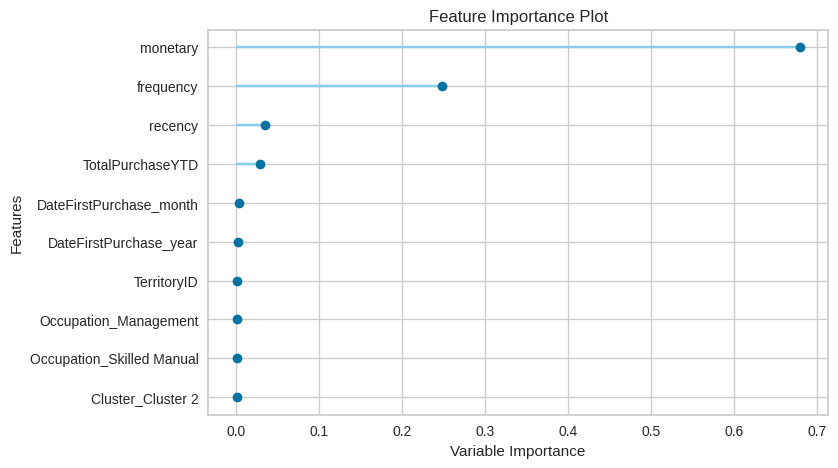

In [ ]:
plot_model(best_model, plot='feature')

Another way to analyze the performance of models is to use the evaluate_model 

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

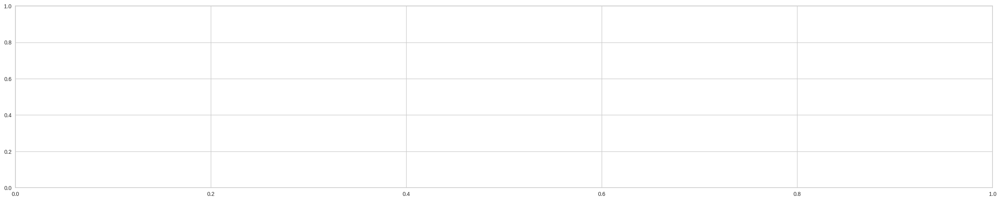

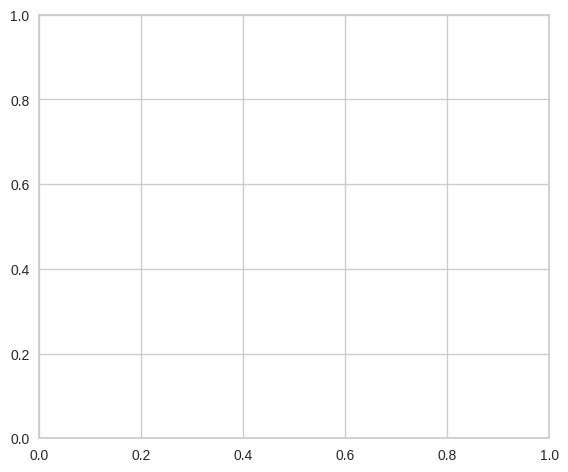

In [ ]:
evaluate_model(best_model)

####Step 6 Predict on Test/Hold-out sample
Before finalizing the model, it is advisable to perform one final check by prediting the test/hold set and reviewing the evaluation metrics. There are 30% (4971 samples) of the data has been separated out as a test sample. All of the evaluation metrics we have seen above are cross-validated results based on the training set (70%) only. Now, using our final trained model stored in the best_model (xgboost), we will predict the hold-out sample and evaluate the metrics to see if they are materially different than the CV results. 



In [ ]:
predict_model(xgboost)

#The MAPE on the test/hold-out set is 0.0484 compared to 0.0404 achieved on rgboost CV result (in section above). 
#This is not a significant diffrence. 

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Extreme Gradient Boosting,8335.9004,355218816.0000,18847.2500,0.9988,0.1003,0.0484


,CustomerID,recency,frequency,monetary,Cluster,PersonID,TerritoryID,AccountNumber,rowguid,ModifiedDate,...,YearlyIncome,Gender,TotalChildren,NumberChildrenAtHome,Education,Occupation,HomeOwnerFlag,NumberCarsOwned,lifetime_value,prediction_label
5522,16522,295,2,4698.759766,Cluster 2,16300.0,9,AW00016522,02859F8C-2DEA-435A-9B12-2F07F5C1B399,2014-09-12 11:15:07,...,0-25000,F,1.0,1.0,High School,Manual,1.0,0.0,1.952335e+06,2.018268e+06
5090,16090,105,4,604.960022,Cluster 0,11868.0,6,AW00016090,67C761AE-9E8E-4BBC-BD78-6438BED6E85C,2014-09-12 11:15:07,...,25001-50000,F,2.0,2.0,Bachelors,Skilled Manual,1.0,1.0,1.544160e+05,1.561944e+05
14267,25306,257,4,1769.959961,Cluster 2,5722.0,8,AW00025306,1C54BD67-7B5F-4A44-9284-221DC9790FFA,2014-09-12 11:15:07,...,25001-50000,M,1.0,1.0,Bachelors,Skilled Manual,1.0,1.0,3.845238e+05,3.781768e+05
12256,23276,201,2,2393.060059,Cluster 2,17949.0,4,AW00023276,8539EDBE-67B7-4309-9794-AA8B5E7BB8ED,2014-09-12 11:15:07,...,25001-50000,M,2.0,0.0,High School,Skilled Manual,1.0,2.0,1.106790e+06,1.084435e+06
15393,26437,61,3,1953.469971,Cluster 0,2672.0,9,AW00026437,01782D76-E95E-4747-AF4C-10D5AE8ACAA7,2014-09-12 11:15:07,...,greater than 100000,F,0.0,5.0,Partial College,Management,1.0,3.0,6.934818e+05,6.926986e+05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14237,25276,172,3,38.880001,Cluster 0,8437.0,1,AW00025276,F6A76DAA-857A-4024-A706-8A6A315D1B5C,2014-09-12 11:15:07,...,25001-50000,F,0.0,0.0,Partial College,Skilled Manual,0.0,1.0,1.236384e+04,1.266520e+04
12647,23671,124,3,193.979996,Cluster 0,3852.0,1,AW00023671,82985E8A-DDF5-47CE-A063-59C74A62F1D1,2014-09-12 11:15:07,...,50001-75000,M,3.0,0.0,Graduate Degree,Management,1.0,2.0,6.478932e+04,5.961217e+04
11736,22755,47,1,4.990000,Cluster 0,18016.0,6,AW00022755,41AA7E5E-380D-40FB-8A7E-0E778CC1439A,2014-09-12 11:15:07,...,50001-75000,M,2.0,1.0,Partial College,Professional,1.0,1.0,5.384210e+03,5.043682e+03
9547,20557,114,3,64.970001,Cluster 0,19828.0,10,AW00020557,4C1B00B8-D2BB-43C5-9ACB-719C0E11E00B,2014-09-12 11:15:07,...,greater than 100000,F,3.0,4.0,High School,Professional,1.0,4.0,2.191655e+04,2.108128e+04


####Step 7: Finalize model for Deployment 


In [ ]:
final_xgboost = finalize_model(xgboost)
print(final_xgboost)

Pipeline(memory=FastMemory(location=/tmp/joblib),
         steps=[('date_feature_extractor',
                 TransformerWrapper(include=['ModifiedDate',
                                             'DateFirstPurchase', 'BirthDate'],
                                    transformer=ExtractDateTimeFeatures())),
                ('numerical_imputer',
                 TransformerWrapper(include=['recency', 'frequency', 'monetary',
                                             'PersonID', 'TerritoryID',
                                             'BusinessEntityID',
                                             'TotalPurchaseYTD',
                                             'TotalC...
                              feature_types=None, gamma=None, gpu_id=None,
                              grow_policy=None, importance_type=None,
                              interaction_constraints=None, learning_rate=None,
                              max_bin=None, max_cat_threshold=None,
                   

Caution: Once the model is finalized using the finalize_model, the entire dataset including the test/hold-out set is used for training. As such, if the model is used for predicions on the hold-out set after finalize_model is used, the information grid printed will be misleading as you are trying to predict on the same data that was used for modeling. 
E.g. predict_model(final_xgboost) - the result will be different, compared to predict_model(xgboost). This is because the final_xgboost variable is trained on the complete dataset including the test/hold-out set.  

####Step 8: Predict on Unseen Data 
The label column is added onto the data_unseen set. The label is the prediced value using the final_xgboost model. 

In [ ]:
unseen_prediction = predict_model(final_xgboost, data=data_unseen, round=0)

unseen_prediction.head()

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Extreme Gradient Boosting,7291,223947616,14965,1,0,0


,CustomerID,recency,frequency,monetary,Cluster,PersonID,TerritoryID,AccountNumber,rowguid,ModifiedDate,...,YearlyIncome,Gender,TotalChildren,NumberChildrenAtHome,Education,Occupation,HomeOwnerFlag,NumberCarsOwned,lifetime_value,prediction_label
17,11017,106,4,6434.310059,Cluster 0,2521.0,9,AW00011017,BEEB1F0C-84B2-4B63-AE28-B7D02F10924E,2014-09-12 11:15:07,...,0-25000,F,4.0,0.0,High School,Skilled Manual,1.0,2.0,1.640749e+06,1.717340e+06
19,11019,16,33,882.700012,Cluster 0,5132.0,6,AW00011019,794FAD9A-063A-4C68-9BB0-FC956039CC66,2014-09-12 11:15:07,...,25001-50000,M,0.0,0.0,High School,Skilled Manual,0.0,2.0,2.969082e+04,2.723941e+04
23,11023,14,6,122.239998,Cluster 0,4373.0,4,AW00011023,A2833BD8-44A8-4665-808E-33E19ECD7F54,2014-09-12 11:15:07,...,25001-50000,M,0.0,0.0,Partial College,Skilled Manual,1.0,1.0,2.265515e+04,2.274377e+04
26,11026,105,7,6575.790039,Cluster 0,2857.0,9,AW00011026,E0834203-936E-4403-A732-3213D27EA4C7,2014-09-12 11:15:07,...,25001-50000,M,2.0,0.0,Partial College,Clerical,0.0,2.0,9.591259e+05,9.369996e+05
61,11061,228,6,8129.020020,Cluster 2,18220.0,9,AW00011061,6941B86B-CD2E-4E0A-9020-BF1B2C53D3EB,2014-09-12 11:15:07,...,75001-100000,M,2.0,0.0,Partial College,Skilled Manual,1.0,2.0,1.216643e+06,1.237870e+06


####Step 9: Saving the model

In [ ]:
save_model(final_xgboost, 'Final xgboost model 1Apr2023')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=FastMemory(location=/tmp/joblib),
          steps=[('date_feature_extractor',
                  TransformerWrapper(include=['ModifiedDate',
                                              'DateFirstPurchase', 'BirthDate'],
                                     transformer=ExtractDateTimeFeatures())),
                 ('numerical_imputer',
                  TransformerWrapper(include=['recency', 'frequency', 'monetary',
                                              'PersonID', 'TerritoryID',
                                              'BusinessEntityID',
                                              'TotalPurchaseYTD',
                                              'TotalC...
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy=None, importance_type=None,
                               interaction_constraints=None, learning_rate=None,
                               max_bin=None, max_cat_threshold=None,
    

####Step 10: Loading the saved model 
To load a saved model at a future date in the same or an alternative environment, we would use PyCaret's load_model function and then easily apply the model on new unseedn data for prediction. 

use this code: 
* saved_final_xgboost = load_model('Final xgboost model 1Apr2023')

#Further analysis of Cluster 2 (to compare with Cluster 0)


- Cluster 2 is the most important customers for bicycle company based on the result of kmeans clustering done above. 


###Step 1: to check rfm_demograpics data frame and extra Cluster 2 and Cluster 0

In [ ]:
rfm_demographics.head(2)

,CustomerID,recency,frequency,monetary,Cluster,lifetime_value,PersonID,TerritoryID,AccountNumber,rowguid,...,BirthDate,MaritalStatus,YearlyIncome,Gender,TotalChildren,NumberChildrenAtHome,Education,Occupation,HomeOwnerFlag,NumberCarsOwned
0,11000,270,8,8248.990234,Cluster 2,882641.955078,13531.0,9,AW00011000,477586B3-2977-4E54-B1A8-569AB2C7C4D4,...,1966-04-08,M,75001-100000,M,2.0,0.0,Bachelors,Professional,1.0,0.0
1,11001,49,11,6383.879883,Cluster 0,625039.875799,5454.0,9,AW00011001,C32A8084-9077-4F13-9738-1E2DA7C1DCD9,...,1965-05-14,S,50001-75000,M,3.0,3.0,Bachelors,Professional,0.0,1.0


In [ ]:
rfm_demographics.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18409 entries, 0 to 18408
Data columns (total 24 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   CustomerID            18409 non-null  object        
 1   recency               18409 non-null  int32         
 2   frequency             18409 non-null  int32         
 3   monetary              18409 non-null  float32       
 4   Cluster               18409 non-null  object        
 5   lifetime_value        18409 non-null  float64       
 6   PersonID              18409 non-null  float64       
 7   TerritoryID           18409 non-null  int64         
 8   AccountNumber         18409 non-null  object        
 9   rowguid               18409 non-null  object        
 10  ModifiedDate          18409 non-null  datetime64[ns]
 11  BusinessEntityID      18409 non-null  int64         
 12  TotalPurchaseYTD      18409 non-null  float64       
 13  DateFirstPurchas

In [ ]:
# since cluster 2 is the most important
# extract out cluster 2 customer demographics and compare to the biggest cluster (cluster 0)
cluster_2 = rfm_demographics[rfm_demographics['Cluster'] == 'Cluster 2']
cluster_0 = rfm_demographics[rfm_demographics['Cluster'] == 'Cluster 0']


###Step 2: to compare important numeric features (i.e. monetary, frequency,TotalPurchaseYTD and lifetime_value) 

In [ ]:
# Calculate statistics for important features in each cluster 
cluster2_stats = pd.DataFrame(cluster_2[['monetary', 'frequency', 'TotalPurchaseYTD', 'lifetime_value']]).agg(['mean']).T
cluster0_stats = pd.DataFrame(cluster_0)[['monetary', 'frequency', 'TotalPurchaseYTD', 'lifetime_value']].agg(['mean']).T

# Merge the statistics for both clusters into a single dataframe
stats_df = pd.merge(cluster2_stats, cluster0_stats, left_index=True, right_index=True, suffixes=[' Cluster 2', ' Cluster 0'])

# Print the statistics dataframe
stats_df

,mean Cluster 2,mean Cluster 0
monetary,1478.123657,1633.334595
frequency,2.914322,3.634483
TotalPurchaseYTD,233.980825,475.124271
lifetime_value,400924.528480,452026.217828


Based on the summary statistics, we can conclude the following:

- Customers in Cluster 0 have a higher mean for monetary value compared to customers in Cluster 2.
- Customers in Cluster 0 have a higher mean for total purchase YTD and frequency compared to customers in Cluster 2.
- Customers in Cluster 0 have a higher mean for lifetime value compared to customers in Cluster 2.

###Step 3: to compare important catergorical features (i.e. Education and Yearly Income)

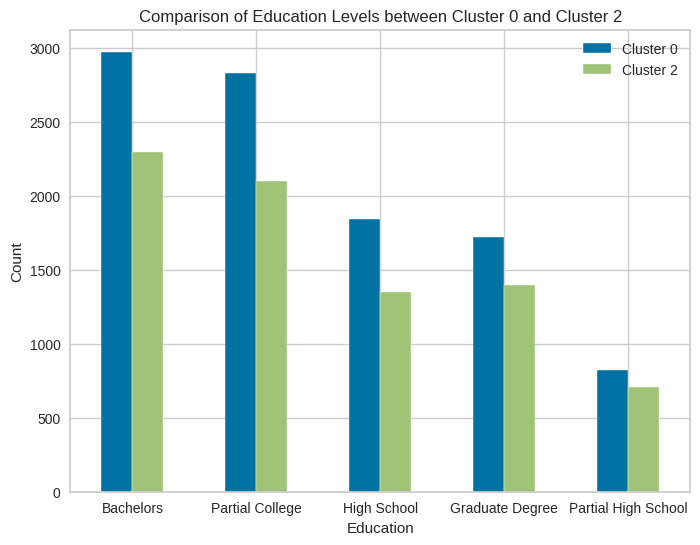

In [ ]:
# Count the occurrences of each education level in each cluster
cluster0_counts = pd.Series(cluster_0['Education']).value_counts()
cluster2_counts = pd.Series(cluster_2['Education']).value_counts()

# Combine the counts into a single DataFrame
df = pd.concat([cluster0_counts, cluster2_counts], axis=1, keys=['Cluster 0', 'Cluster 2']).fillna(0)

# Plot the data
ax = df.plot(kind='bar', figsize=(8,6), rot=0)

# Add axis labels and title
ax.set_xlabel('Education')
ax.set_ylabel('Count')
ax.set_title('Comparison of Education Levels between Cluster 0 and Cluster 2')

# Show the plot
plt.show()


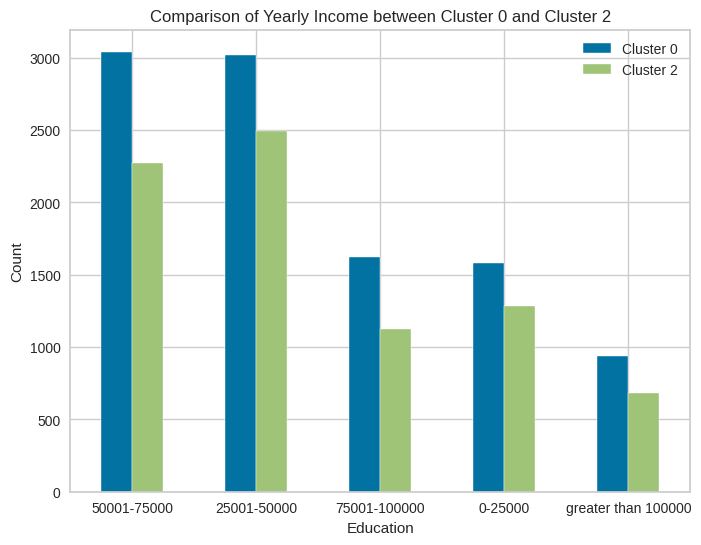

In [ ]:
# Count the occurrences of each education level in each cluster
cluster0_counts = pd.Series(cluster_0['YearlyIncome']).value_counts()
cluster2_counts = pd.Series(cluster_2['YearlyIncome']).value_counts()

# Combine the counts into a single DataFrame
df = pd.concat([cluster0_counts, cluster2_counts], axis=1, keys=['Cluster 0', 'Cluster 2']).fillna(0)

# Plot the data
ax = df.plot(kind='bar', figsize=(8,6), rot=0)

# Add axis labels and title
ax.set_xlabel('Education')
ax.set_ylabel('Count')
ax.set_title('Comparison of Yearly Income between Cluster 0 and Cluster 2')

# Show the plot
plt.show()

Based on the group bar charts above: 

- There are more Bachelors education in cluster 0 compared to cluster 2. 
- There are more 50-75k YearlyIncome in cluster 0 compared to cluster 2. 


###Step 4: Conclusion 
The analysis indicates that Cluster 0 has higher mean values for monetary, total purchase YTD, frequency, and lifetime value compared to Cluster 2. Additionally, Cluster 0 has more customers with bachelor's degrees and a higher number of customers earning from $50,001-$75,000. These findings suggest that Cluster 0 customers are more valuable compared to those in Cluster 2.

# Exploring the Purchase Behavior of Customers in Cluster 0: What Type of Products Do They Buy?"

Assuming that the bicycle company has decided to shift their attention towards Cluster 0, they might be interested in understanding the types of products that these customers are more likely to purchase.

###Step 1: To merge rfm_demographics dataframe with product 

In [ ]:
cluster_0.head(2)

,CustomerID,recency,frequency,monetary,Cluster,lifetime_value,PersonID,TerritoryID,AccountNumber,rowguid,...,BirthDate,MaritalStatus,YearlyIncome,Gender,TotalChildren,NumberChildrenAtHome,Education,Occupation,HomeOwnerFlag,NumberCarsOwned
1,11001,49,11,6383.879883,Cluster 0,625039.875799,5454.0,9,AW00011001,C32A8084-9077-4F13-9738-1E2DA7C1DCD9,...,1965-05-14,S,50001-75000,M,3.0,3.0,Bachelors,Professional,0.0,1.0
12,11012,105,5,81.260002,Cluster 0,16593.292436,11663.0,1,AW00011012,2FC32AD9-A7E0-4505-9BA8-E5D2FB46AE4D,...,1968-01-18,M,75001-100000,F,2.0,0.0,Bachelors,Management,1.0,2.0
